# Test the hologram performances with HD111980 data 30 may 2017
==================================================================================================

- author : Sylvie
- date   : October 2nd th 2017
- update : October 3rd 2017


Inspired from Jeremy's work on PN and QSO

> This notebook start from images that has been deflated. So the task. is the following
> 1) Find the central star position
> 2) Find the rotation using the Hessian technique (from Jeremy)
> 3) Turn the images and cut
> 4) save for later analysis

The coordinate of the zero th order must be remember as well as the rotation angle


#### problem because limitation in output of data

- firt I tried to generate a config file for jupyter

If you ran jupyter notebook --generate-config to create it, it should be in the correct place already. If not, try putting it at ~/.jupyter/jupyter_notebook_config.py

- and I set : 
> c.NotebookApp.iopub_data_rate_limit = 1000000

but it failed again so I launch jupyter as follow:

> jupyter notebook --NotebookApp.iopub_data_rate_limit=10000000 full_baseanalysis.ipynb 

So it behaves better


- however Jupyter notbook may not save the change !!!!!!!!

In [1]:
%%javascript
var kernel = IPython.notebook.kernel;
var thename = window.document.getElementById("notebook_name").innerHTML;
var command = "theNotebook = " + "'"+thename+"'";
kernel.execute(command);

<IPython.core.display.Javascript object>

In [2]:
%matplotlib inline
%load_ext autoreload
%autoreload 2

print theNotebook
from IPython.display import Image, display
import sys
sys.path.append("../../common_tools/")
from common_notebook import *

init_notebook()

full_baseanalysis
ccdproc version 1.2.0
bottleneck version 1.2.1
/Users/dagoret/MacOSX/GitHub/LSST/CTIOAnaJun2017/CTIOAnaJun2017/ana_30may17/HD111980


In [3]:
from astropy.modeling import models, fitting

In [4]:
import pandas as pd

# Input directory

- specify which are the input images

In [5]:
inputdir="/Users/dagoret/DATA/CTIODataJune2017_reducedRed/data_30may17"
MIN_IMGNUMBER=58
MAX_IMGNUMBER=190
date="20170530"
object_name='HD111980'
tag = "reduc"
SelectTagRe='^%s_%s_([0-9]+).fits$' % (tag,date) # regular expression to select the file
SearchTagRe='^%s_%s_[0-9]+.fits$' % (tag,date)
NBIMGPERROW=2

# Output directory

- specify where are stored the cut images as well as the plot produced

In [6]:
dir_top_images="images_notebooks/"+theNotebook ### Top directory to save images
ensure_dir(dir_top_images) # create that directory

outputdir="./cut_fitsimages"
ensure_dir(outputdir)

# Location of the spectra

In [13]:
dirlist_all = [inputdir] # only one directory to process
sorted_numbers,sorted_files = MakeFileList(dirlist_all,MIN_IMGNUMBER,MAX_IMGNUMBER,SelectTagRe,SearchTagRe) 

all_dates,all_airmass,all_images,all_titles,all_header,all_expo,all_filt=BuildImages(sorted_files,sorted_numbers,object_name)

print 'Number of images:',len(all_images)

Number of images: 133


# Find various filters

- because the spectra vary from one disperser to another, one must make the list of images identifiers for a given disperser

In [9]:
print all_filt

['dia Thor300', 'dia Thor300', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg

## Define the list of the filter names

- be carefull : these name may change from one run or night to another
- one must change accordingly

In [10]:
filt_names= ['dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'Unknown']

## Function to find the list of ids

- one list per disperser

In [11]:
def get_filt_idx(listoffilt):
    
    filt0_idx=[]
    filt1_idx=[]
    filt2_idx=[]
    filt3_idx=[]
    filt4_idx=[]
    filt5_idx=[]
    index=0
    for filt in listoffilt:
        if filt == 'dia Ron400':
            filt0_idx.append(index)
        elif filt == 'dia Thor300':
            filt1_idx.append(index)
        elif filt == 'dia HoloPhP':
            filt2_idx.append(index)
        elif filt == 'dia HoloPhAg':
            filt3_idx.append(index)
        elif filt == 'dia HoloAmAg':
            filt4_idx.append(index)
        else :
            filt5_idx.append(index)
    
        index+=1
    
    filt0_idx=np.array(filt0_idx)
    filt1_idx=np.array(filt1_idx)
    filt2_idx=np.array(filt2_idx)
    filt3_idx=np.array(filt3_idx)
    filt4_idx=np.array(filt4_idx)
    filt5_idx=np.array(filt5_idx)
    
    return filt0_idx,filt1_idx,filt2_idx,filt3_idx,filt4_idx,filt5_idx
    

- apply the get ids

In [12]:
filt0_idx,filt1_idx,filt2_idx,filt3_idx,filt4_idx,filt5_idx=get_filt_idx(all_filt)

In [13]:
print 'filt0_idx :: ',filt0_idx
print 'filt1_idx :: ',filt1_idx
print 'filt2_idx :: ',filt2_idx
print 'filt3_idx :: ',filt3_idx
print 'filt4_idx :: ',filt4_idx
print 'filt5_idx :: ',filt5_idx

filt0_idx ::  [  2   7  12  17  22  27  32  37  42  47  52  57  62  67  72  77  82  87
  92  97 102 107 112 117 122 127 132]
filt1_idx ::  [  0   1   3   8  13  18  23  28  33  38  43  48  53  58  63  68  73  78
  83  88  93  98 103 108 113 118 123 128]
filt2_idx ::  [  4   9  14  19  24  29  34  39  44  49  54  59  64  69  74  79  84  89
  94  99 104 109 114 119 124 129]
filt3_idx ::  [  5  10  15  20  25  30  35  40  45  50  55  60  65  70  75  80  85  90
  95 100 105 110 115 120 125 130]
filt4_idx ::  [  6  11  16  21  26  31  36  41  46  51  56  61  66  71  76  81  86  91
  96 101 106 111 116 121 126 131]
filt5_idx ::  []


# Example for one raw image


- the idea is to check where is the center of the main star
- size 2k x 2 K

In [19]:
sel_index=0

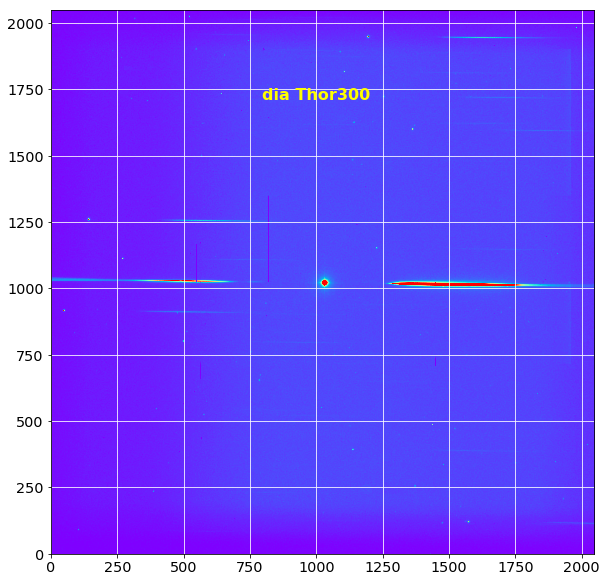

In [20]:
plt.figure(figsize=(10,10))
plt.imshow(all_images[sel_index],origin='lower',cmap='rainbow',vmin=0, vmax=2000)
plt.grid(color='white', ls='solid')
plt.text(1000.,1700,all_filt[sel_index],verticalalignment='bottom', horizontalalignment='center',color='yellow', fontweight='bold',fontsize=16)

In [27]:
def Guess_init_fit(theimage,xmin,xmax,ymin,ymax):
    """
   
    
    """    
    cropped_image=np.copy(theimage[ymin:ymax,xmin:xmax])
    
    profile_y=np.sum(cropped_image,axis=1)
    profile_x=np.sum(cropped_image,axis=0)
    
    theidxmax=np.where(profile_x==profile_x.max())
    theidymax=np.where(profile_y==profile_y.max())
    
    return xmin+theidxmax[0][0],ymin+theidymax[0][0]
    

# Try to fit a 2D gaussian

- Fit a 2D gaussian on intensity of central star


we have to paly with the parameter below to find a common region to find the central star

In [22]:
x0,y0=Guess_init_fit(all_images[sel_index],500,1100,500,1100)

In [23]:
dw=200  # width

In [24]:
print "x0,y0=",x0,y0

x0,y0= 1030 1026


In [25]:
# cut the subimage
cropped_image=np.copy(all_images[sel_index][y0-dw:y0+dw,x0-dw:x0+dw])

In [26]:
NY=cropped_image.shape[0]
NX=cropped_image.shape[1]

In [27]:
# build a mesh grid of x-y
y, x = np.mgrid[:NY,:NX]

In [28]:
z=cropped_image[y,x]

### Notice that with colormesh, one has the same orientation of the image as above

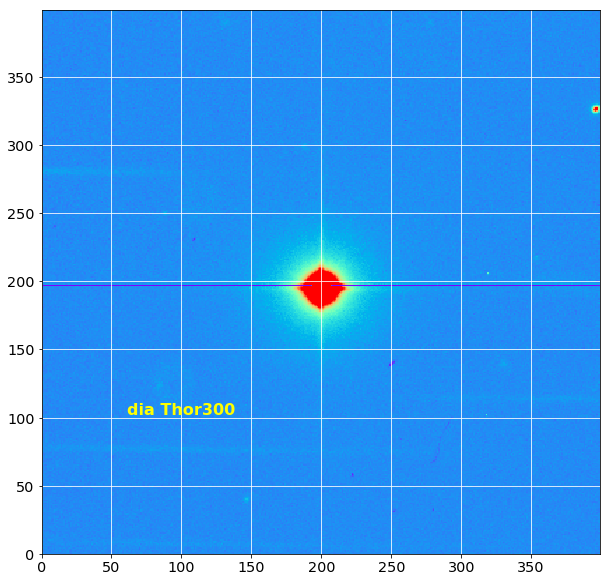

In [29]:
# plot x,y,z
plt.figure(figsize=(10,10))
plt.pcolormesh(x, y, z,cmap='rainbow',vmin=0, vmax=1000)
plt.grid(color='white', ls='solid')
plt.text(100.,100,all_filt[sel_index],verticalalignment='bottom', horizontalalignment='center',color='yellow', fontweight='bold',fontsize=16)

In [30]:
x_mean=NX/2
y_mean=NY/2
z_max=z[y_mean,x_mean]
print x_mean,y_mean,z_max

200 200 57701.0467319


### Make the 2D fit

In [31]:
p_init = models.Gaussian2D(amplitude=z_max,x_mean=x_mean,y_mean=y_mean)
fit_p = fitting.LevMarLSQFitter()

In [32]:
import warnings
p = fit_p(p_init, x, y, z)

In [33]:
print p.x_mean
print p.y_mean
print p.amplitude

Parameter('x_mean', value=200.048221534)
Parameter('y_mean', value=194.560409905)
Parameter('amplitude', value=79435.914155)


In [34]:
new_x0=p.x_mean
new_y0=p.y_mean

### I don't really understand the result of this fit

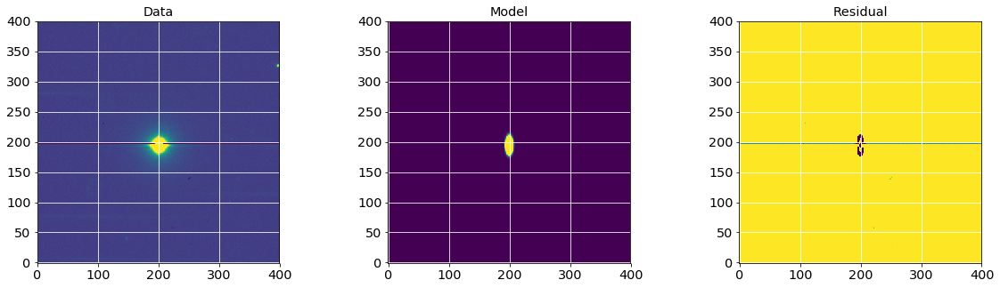

In [35]:
plt.figure(figsize=(20, 5))
plt.subplot(1, 3, 1)
plt.imshow(z, origin='lower', interpolation='nearest', vmin=0, vmax=1000)
plt.grid(color='white', ls='solid')
plt.title("Data")
plt.subplot(1, 3, 2)
plt.imshow(p(x, y), origin='lower', interpolation='nearest', vmin=0,vmax=1000)
plt.grid(color='white', ls='solid')
plt.title("Model")
plt.subplot(1, 3, 3)
plt.imshow(z - p(x, y), origin='lower', interpolation='nearest', vmin=-100,vmax=100)
plt.grid(color='white', ls='solid')
plt.title("Residual")

### Check the result of the fit

- the center of the star is where it is expected (black point)

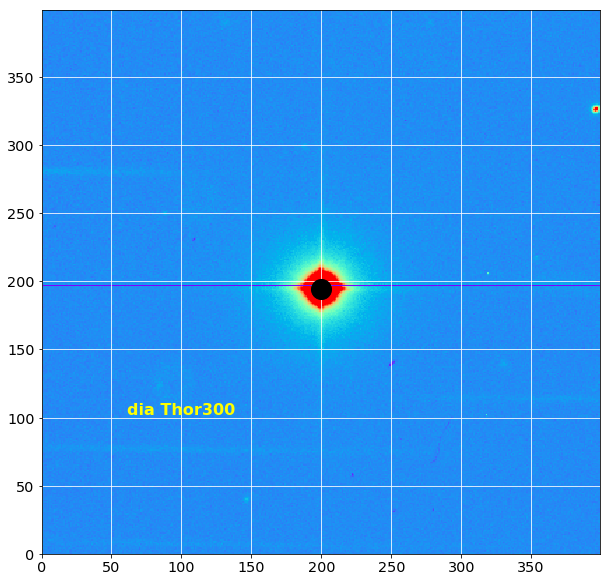

In [36]:
plt.figure(figsize=(10,10))
plt.pcolormesh(x, y, z,cmap='rainbow',vmin=0, vmax=1000)
plt.plot([new_x0],[new_y0],'ko',markersize=20)
plt.grid(color='white', ls='solid')
plt.text(100.,100,all_filt[sel_index],verticalalignment='bottom', horizontalalignment='center',color='yellow', fontweight='bold',fontsize=16)

# Show the images

- So now work on the series of the images

- First look at them
- notice there is a downsampling factor of 10

Processing image 0...
Processing image 1...
Processing image 2...
Processing image 3...
Processing image 4...
Processing image 5...
Processing image 6...
Processing image 7...
Processing image 8...
Processing image 9...
Processing image 10...
Processing image 11...
Processing image 12...
Processing image 13...
Processing image 14...
Processing image 15...
Processing image 16...
Processing image 17...
Processing image 18...
Processing image 19...
Processing image 20...
Processing image 21...
Processing image 22...
Processing image 23...
Processing image 24...
Processing image 25...
Processing image 26...
Processing image 27...
Processing image 28...
Processing image 29...
Processing image 30...
Processing image 31...
Processing image 32...
Processing image 33...
Processing image 34...
Processing image 35...
Processing image 36...
Processing image 37...
Processing image 38...
Processing image 39...
Processing image 40...
Processing image 41...
Processing image 42...
Processing image 43..

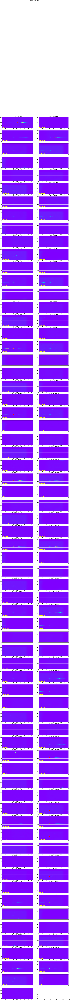

In [37]:
ShowImages(all_images,all_titles,all_filt,object_name,NBIMGPERROW=2,vmin=0,vmax=10000,downsampling=10,verbose=True)

figfilename=os.path.join(dir_top_images,'input_images.pdf')
plt.savefig(figfilename)   

# Show the histograms

- just check the reduction and deflattage is OK

Processing image 0...
Processing image 1...
Processing image 2...
Processing image 3...
Processing image 4...
Processing image 5...
Processing image 6...
Processing image 7...
Processing image 8...
Processing image 9...
Processing image 10...
Processing image 11...
Processing image 12...
Processing image 13...
Processing image 14...
Processing image 15...
Processing image 16...
Processing image 17...
Processing image 18...
Processing image 19...
Processing image 20...
Processing image 21...
Processing image 22...
Processing image 23...
Processing image 24...
Processing image 25...
Processing image 26...
Processing image 27...
Processing image 28...
Processing image 29...
Processing image 30...
Processing image 31...
Processing image 32...
Processing image 33...
Processing image 34...
Processing image 35...
Processing image 36...
Processing image 37...
Processing image 38...
Processing image 39...
Processing image 40...
Processing image 41...
Processing image 42...
Processing image 43..

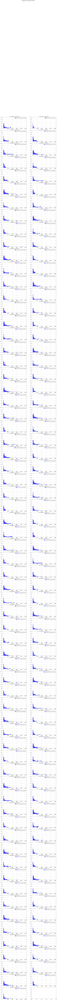

In [38]:
ShowHistograms(all_images,all_titles,all_filt,object_name,
               NBIMGPERROW=2,bins=100,range=(-50,10000),downsampling=10,verbose=True)

#  Guess central position of the central star

- defines two utility functions


In [30]:
def check_bad_guess(xy_guess,filt_idx, sigma_cut=10.):
    """
    function check_bad_guess(xy_guess,filt_idx)
    
    check is the x or y position are too far from the series of other x,y postion for a given disperser
    
    input :
       xy_guess : the x or the y values to be tested
       filt_idx, the list of identifiers of a given disperser
       
    output:
       the_mean : average position
       the_std. : std deviation
       the_bad_idx : the list of identiers that are at more than 3 sigma 
    """
    
    # typical dispersion
    
    the_guess=xy_guess[filt_idx]
    
    the_mean=np.median(the_guess)
    the_std=np.std(the_guess-the_mean)
    
    the_bad=np.where( np.abs(the_guess-the_mean)> 3.*sigma_cut)
    
    the_bad_idx=filt_idx[the_bad]
    
    return int(the_mean),int(the_std),the_bad_idx

In [31]:
def remove_from_bad(arr,index_to_remove):
    """
    """
    
    newarr=arr
    set_rank_to_remove=np.where(arr==index_to_remove)[0]
    if len(set_rank_to_remove)!=0:
        rank_to_remove=set_rank_to_remove[0]
        newarr=np.delete(arr,rank_to_remove)
    return newarr

In [32]:
def guess_central_position(listofimages,DeltaX,DeltaY,dwc,filt0_idx,filt1_idx,filt2_idx,filt3_idx,filt4_idx,filt5_idx):
    """
    Guess the central position of the star
    
    
    output :
         x_guess,y_guess : coordinate of the central star in the frame of the raw image
    """

    
    # Step 1 : do the 2D guassian fit
    
    x_guess = [] 
    y_guess = []
    index=0

    for theimage in listofimages:
        
       
        
        index+=1
        
        
        # try to find a maximum in the region specified here
        # we expect the central star be found at x0c, y0c
        # overwrite x0c and y0c here !!!!!
        x0c,y0c=Guess_init_fit(theimage,DeltaX[0],DeltaX[1],DeltaY[0],DeltaY[1])
        
        # sub-image around the maximum found at center
        # the coordinate of the lower left corner is (x0c-dwc,y0c-dwc) in original coordinate
        sub_image=np.copy(theimage[y0c-dwc:y0c+dwc,x0c-dwc:x0c+dwc]) # make a sub-image
    
        # init the gaussian fit
        NY=sub_image.shape[0]
        NX=sub_image.shape[1]
        y, x = np.mgrid[:NY,:NX]
        z=sub_image[y,x]
    
        # we expect the central star is at the center of the subimage
        x_mean=NX/2
        y_mean=NY/2
        z_max=z[y_mean,x_mean]
    
        # do the gaussian fit
        p_init = models.Gaussian2D(amplitude=z_max,x_mean=x_mean,y_mean=y_mean)
        fit_p = fitting.LevMarLSQFitter()
    
        p = fit_p(p_init, x, y, z)
    
        x_fit= p.x_mean
        y_fit= p.y_mean
        z_fit= p.amplitude
    
       
    
        # put the center found by fit in the original image coordinate system
        #--------------------------------------------------------------------
        
        x_star_original=x0c-dwc+x_fit
        y_star_original=y0c-dwc+y_fit
        
        x_guess.append(x_star_original)
        y_guess.append(y_star_original)
        
        #if index%5==0 :
        print index-1,': (x_guess,y_guess)=',x_star_original,y_star_original

    x_guess=np.array(x_guess)
    y_guess=np.array(y_guess)
    
    
    # Step 2 : check if the fit is creazy 
    # if so, use the average center for the given disperser
    
    print 'Check fit quality :: '
    print ' ==========================='
    
    # find bad ids for filter 1 and correct for 
        
        
    # filter 0        
    aver_x0,std_x0,bad_idx_x0=check_bad_guess(x_guess,filt0_idx)
    if (bad_idx_x0.shape[0] != 0):
        print 'bad filt 0 x : ',bad_idx_x0
        x_guess[bad_idx_x0]=aver_x0    # do the correction
    
    aver_y0,std_y0,bad_idx_y0=check_bad_guess(y_guess,filt0_idx)
    if (bad_idx_y0.shape[0] != 0):
        print 'bad filt 0 y : ',bad_idx_y0
        y_guess[bad_idx_y0]=aver_y0    # do the correction     
        

    # filter 1        
    aver_x1,std_x1,bad_idx_x1=check_bad_guess(x_guess,filt1_idx)
    if (bad_idx_x1.shape[0] != 0):
        print 'bad filt 1 x : ',bad_idx_x1
        
        # !!!!!!!!!!!!!!!!!!!!!! Special for first Thorlab image
        idx_to_remove=0
        print 'remove from bad idx x1 : ',idx_to_remove
        bad_idx_x1=remove_from_bad(bad_idx_x1,idx_to_remove)           
        print 'new bad filt 1 x : ',bad_idx_x1
        x_guess[bad_idx_x1]=aver_x1    # do the correction
    
    aver_y1,std_y1,bad_idx_y1=check_bad_guess(y_guess,filt1_idx)
    if (bad_idx_y1.shape[0] != 0):
        
        print 'bad filt 1 y : ',bad_idx_y1
         # !!!!!!!!!!!!!!!!!!!!!! Special for first Thorlab image
        idx_to_remove=0        
        print 'remove from bad idx y1 : ',idx_to_remove
        bad_idx_y1=remove_from_bad(bad_idx_y1,idx_to_remove)           
        print 'new bad filt 1 y : ',bad_idx_y1
        
        y_guess[bad_idx_y1]=aver_y1    # do the correction
    
 
    # filter 2        
    aver_x2,std_x2,bad_idx_x2=check_bad_guess(x_guess,filt2_idx)
    if (bad_idx_x2.shape[0] != 0):
        print 'bad filt 2 x : ',bad_idx_x2
        x_guess[bad_idx_x2]=aver_x2    # do the correction
    
    aver_y2,std_y2,bad_idx_y2=check_bad_guess(y_guess,filt2_idx)
    if (bad_idx_y2.shape[0] != 0):
        print 'bad filt 2 y : ',bad_idx_y2
        y_guess[bad_idx_y2]=aver_y2    # do the correction
        
        
    # filter 3        
    aver_x3,std_x3,bad_idx_x3=check_bad_guess(x_guess,filt3_idx)
    if (bad_idx_x3.shape[0] != 0):
        print 'bad bad filt 3 x : ',bad_idx_x3
        x_guess[bad_idx_x3]=aver_x3    # do the correction
    
    aver_y3,std_y3,bad_idx_y3=check_bad_guess(y_guess,filt3_idx)
    if (bad_idx_y3.shape[0] != 0):
        print 'bad filt 3 y : ',bad_idx_y3
        y_guess[bad_idx_y3]=aver_y3    # do the correction
        
    # filter 4        
    aver_x4,std_x4,bad_idx_x4=check_bad_guess(x_guess,filt4_idx)
    if (bad_idx_x4.shape[0] != 0):
        print 'bad filt 4 x : ',bad_idx_x4
        x_guess[bad_idx_x4]=aver_x4    # do the correction
    
    aver_y4,std_y4,bad_idx_y4=check_bad_guess(y_guess,filt4_idx)
    if (bad_idx_y4.shape[0] != 0):
        print 'bad filt 4 y : ',bad_idx_y4
        y_guess[bad_idx_y4]=aver_y4    # do the correction        
    
    
    return x_guess,y_guess

## Compute the position of central star

In [42]:
# guess the region where the maximum is
Delta_x0=[500,1100]
Delta_y0=[500,1100]
dwc=200

x_guess,y_guess=guess_central_position(all_images,Delta_x0,Delta_y0,dwc,filt0_idx,filt1_idx,filt2_idx,filt3_idx,filt4_idx,filt5_idx)

0 : (x_guess,y_guess)= 1030.04822153 1020.56040991
1 : (x_guess,y_guess)= 778.033946597 701.43797984
2 : (x_guess,y_guess)= 780.487914858 702.066638222
3 : (x_guess,y_guess)= 780.260692197 702.088215232
4 : (x_guess,y_guess)= 780.224633554 701.004145141
5 : (x_guess,y_guess)= 780.635475462 701.334028079
6 : (x_guess,y_guess)= 780.279874743 700.4620186
7 : (x_guess,y_guess)= 778.675985822 700.794601937
8 : (x_guess,y_guess)= 778.772553896 701.944983401
9 : (x_guess,y_guess)= 778.029902458 700.991294061
10 : (x_guess,y_guess)= 778.993977655 700.881049203
11 : (x_guess,y_guess)= 778.010426541 699.696069849
12 : (x_guess,y_guess)= 776.236812548 700.120787955
13 : (x_guess,y_guess)= 775.820653912 700.226915685
14 : (x_guess,y_guess)= 776.263937098 697.248169959
15 : (x_guess,y_guess)= 776.652894242 697.249977413
16 : (x_guess,y_guess)= 774.894348515 698.107204011
17 : (x_guess,y_guess)= 775.621977569 697.494803134
18 : (x_guess,y_guess)= 775.828258291 698.702559505
19 : (x_guess,y_guess)= 7

# Save x_guess, y_guess in a file

In [43]:
ar = {'x_guess' :x_guess, 'y_guess' : y_guess}
df = pd.DataFrame(ar)

In [44]:
df.head()

,x_guess,y_guess
0,1030.048222,1020.560410
1,778.033947,701.437980
2,749.000000,702.066638
3,780.260692,702.088215
4,780.224634,701.004145


In [45]:
df.tail()

,x_guess,y_guess
128,753.0,689.734357
129,750.0,687.533545
130,749.0,685.587139
131,748.0,688.759366
132,749.0,688.554547


In [46]:
df.describe()

,x_guess,y_guess
count,133.000000,133.000000
mean,752.868749,691.243726
std,29.557549,29.440896
min,719.792655,677.007513
25%,735.121298,684.085986
50%,749.895427,686.867826
75%,766.257261,693.275108
max,1030.048222,1020.560410


In [47]:
df.to_csv('x_y_guess.csv')

In [48]:
df2=pd.read_csv('x_y_guess.csv')

In [49]:
df2.head()

,Unnamed: 0,x_guess,y_guess
0,0,1030.048222,1020.560410
1,1,778.033947,701.437980
2,2,749.000000,702.066638
3,3,780.260692,702.088215
4,4,780.224634,701.004145


In [50]:
x_guess=df2["x_guess"]
y_guess=df2["y_guess"]

# Cut image

- cut the image around the spectra
- the width in Y is DeltaY=100 pixel above and down

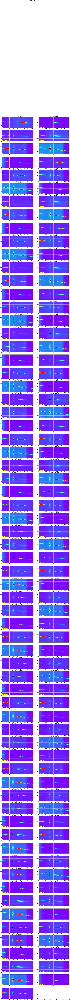

In [51]:
DeltaY=[100]*len(all_images)
DeltaX=[2000]*len(all_images)  # must be very large to have correct x positions

images_raw=ShowCenterImages(x_guess,y_guess,DeltaX,DeltaY,all_images,all_titles,all_filt,object_name,NBIMGPERROW=2,vmin=0,vmax=2000,target_pos=np.array([x_guess,y_guess]).T)
figfilename=os.path.join(dir_top_images,'cut_images.pdf')
plt.savefig(figfilename)   

# Save cut images

- save the series of cut images called **images_raw** in a file


In [52]:
newfullfilenames=[]
for idx,f in np.ndenumerate(sorted_files):
    short_infilename=f.split("/")[-1]
    short_partfilename=re.findall('^%s_(.*)' % tag,short_infilename)
    short_outfilename='cutimg_'+short_partfilename[0]
    newfullfilename=os.path.join(outputdir,short_outfilename)
    newfullfilenames.append(newfullfilename)
    
for idx,f in np.ndenumerate(newfullfilenames):
    prihdu = fits.PrimaryHDU(header=all_header[idx[0]],data=images_raw[idx[0]])
    thdulist = fits.HDUList(prihdu)
    thdulist.writeto(f,overwrite=True)

!ls -l cut_fitsimages/*

-rw-r--r--  1 dagoret  staff  3288960 Oct  2 21:52 cut_fitsimages/cutimg_20170530_058.fits
-rw-r--r--  1 dagoret  staff  3288960 Oct  2 21:52 cut_fitsimages/cutimg_20170530_059.fits
-rw-r--r--  1 dagoret  staff  3288960 Oct  2 21:52 cut_fitsimages/cutimg_20170530_060.fits
-rw-r--r--  1 dagoret  staff  3288960 Oct  2 21:52 cut_fitsimages/cutimg_20170530_061.fits
-rw-r--r--  1 dagoret  staff  3288960 Oct  2 21:52 cut_fitsimages/cutimg_20170530_062.fits
-rw-r--r--  1 dagoret  staff  3288960 Oct  2 21:52 cut_fitsimages/cutimg_20170530_063.fits
-rw-r--r--  1 dagoret  staff  3288960 Oct  2 21:52 cut_fitsimages/cutimg_20170530_064.fits
-rw-r--r--  1 dagoret  staff  3288960 Oct  2 21:52 cut_fitsimages/cutimg_20170530_065.fits
-rw-r--r--  1 dagoret  staff  3288960 Oct  2 21:52 cut_fitsimages/cutimg_20170530_066.fits
-rw-r--r--  1 dagoret  staff  3288960 Oct  2 21:52 cut_fitsimages/cutimg_20170530_067.fits
-rw-r--r--  1 dagoret  staff  3288960 Oct  2 21:52 cut_fitsimages/cutimg_20170530_068.fits

# Find the optimal rotation of the spectra
============================

In [7]:
inputdir="./cut_fitsimages"
SelectTagRe='^cutimg_%s_([0-9]+).fits$' % date # regular expression to select the file
SearchTagRe='^cutimg_%s_[0-9]+.fits$' % date

outputdir="./rotated_fitsimages"
ensure_dir(outputdir)

sorted_numbers,sorted_files = MakeFileList([inputdir],MIN_IMGNUMBER,MAX_IMGNUMBER,SelectTagRe,SearchTagRe) 

all_dates,all_airmass,all_images,all_titles,all_header,all_expo,all_filt=BuildImages(sorted_files,sorted_numbers,object_name)

print 'Number of images:',len(all_images)

Number of images: 133


In [8]:
df=pd.read_csv('x_y_guess.csv')
x_guess=df["x_guess"]
y_guess=df["y_guess"]
DeltaY=[100]*len(all_images)

In [42]:
df.head()

,Unnamed: 0,x_guess,y_guess
0,0,1030.048222,1020.560410
1,1,778.033947,701.437980
2,2,749.000000,702.066638
3,3,780.260692,702.088215
4,4,780.224634,701.004145


## Find rotation by Hessian analysis

La méthode s'inspire des techniques de détection de filmanents dans le milieu interstellaire.
Elle est décrite dans https://arxiv.org/pdf/1409.6728.pdf section 4.1.
Documentation sur le calcul du Hessien : http://scikit-image.org/docs/dev/api/skimage.feature.html#skimage.feature.hessian_matrix

### Test rotation optimal settings

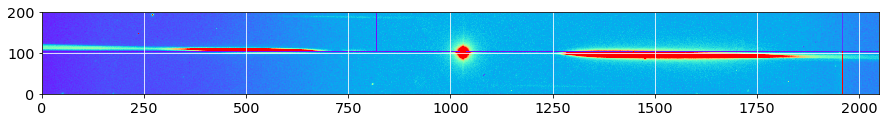

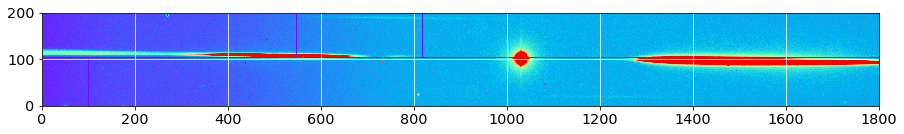

In [14]:
sel=0
image_sel=np.copy(all_images[sel])
y0=DeltaY[sel]
x0=x_guess[sel]

width_cut = 100
right_edge = 1800

plt.imshow(image_sel,origin='lower',cmap='rainbow',vmin=-10,vmax=800)
plt.grid(color='white', ls='solid')
plt.show()

region=np.copy(image_sel[y0-width_cut:y0+width_cut,0:right_edge])
data=np.copy(region)
plt.imshow(data,origin='lower',cmap='rainbow',vmin=-10,vmax=800)
plt.grid(color='white', ls='solid')
plt.show()

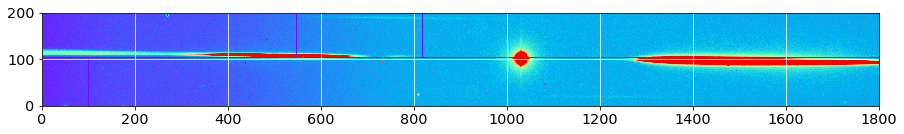

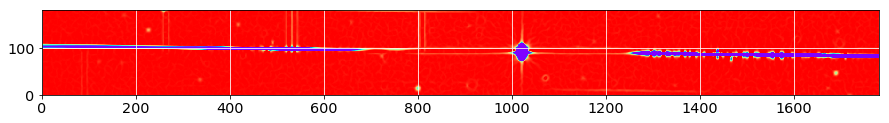

In [15]:
# le paramètre sigma permet de lisser le hessien
Hxx, Hxy, Hyy = hessian_matrix(data, sigma=3, order = 'xy')
lambda_plus = 0.5*( (Hxx+Hyy) + np.sqrt( (Hxx-Hyy)**2 +4*Hxy*Hxy) )
lambda_minus = 0.5*( (Hxx+Hyy) - np.sqrt( (Hxx-Hyy)**2 +4*Hxy*Hxy) )
theta = 0.5*np.arctan2(2*Hxy,Hyy-Hxx)*180/np.pi

margin_cut = 10

lambda_minus = lambda_minus[margin_cut:-margin_cut,margin_cut:-margin_cut]
lambda_plus = lambda_plus[margin_cut:-margin_cut,margin_cut:-margin_cut]
theta = theta[margin_cut:-margin_cut,margin_cut:-margin_cut]

plt.imshow(data,origin='lower',cmap='rainbow',vmin=-10,vmax=800)
plt.grid(color='white', ls='solid')
plt.show()
plt.imshow(lambda_minus,origin='lower',cmap='rainbow',vmin=-10,vmax=0)
plt.grid(color='white', ls='solid')
plt.show()

Number of remaining pixels : 12786


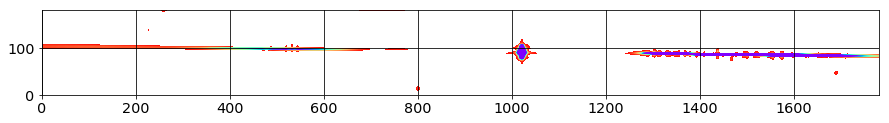

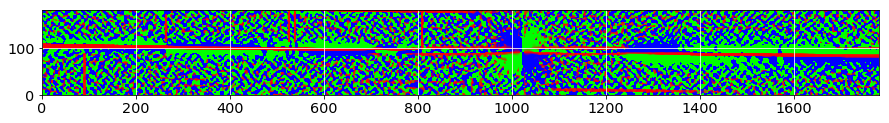

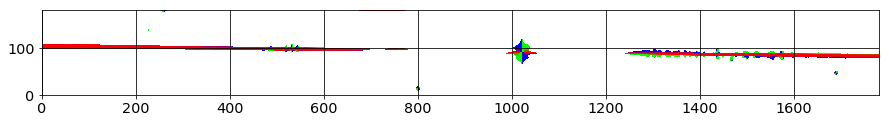

In [16]:
lambda_threshold = -2

mask = np.where(lambda_minus>lambda_threshold)
lambda_mask = np.copy(lambda_minus)
lambda_mask[mask]=np.nan

theta_mask = np.copy(theta)
theta_mask[mask]=np.nan

print 'Number of remaining pixels :',len(lambda_mask[~np.isnan(lambda_mask)])

plt.imshow(lambda_mask,origin='lower',cmap='rainbow',vmin=-100,vmax=0)
plt.grid(color='black', ls='solid')
plt.show()

plt.imshow(theta,origin='lower',cmap=cm.brg,vmin=-30,vmax=30)
plt.grid(color='white', ls='solid')
plt.show()

plt.imshow(theta_mask,origin='lower',cmap=cm.brg,vmin=-30,vmax=30)
plt.grid(color='black', ls='solid')
plt.show()

Number of remaining pixels : 9726


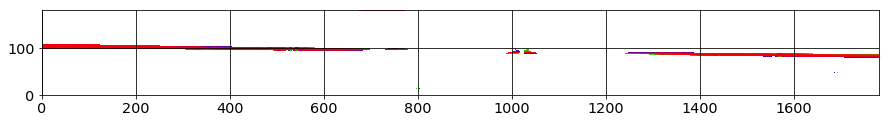

In [17]:
deg_threshold = 20

mask2 = np.where(np.abs(theta)>deg_threshold)
theta_mask[mask2] = np.nan
print 'Number of remaining pixels :',len(theta_mask[~np.isnan(theta_mask)])
plt.imshow(theta_mask,origin='lower',cmap=cm.brg,vmin=-deg_threshold,vmax=deg_threshold)
plt.grid(color='black', ls='solid')
plt.show()

Angle median : -0.631275497186


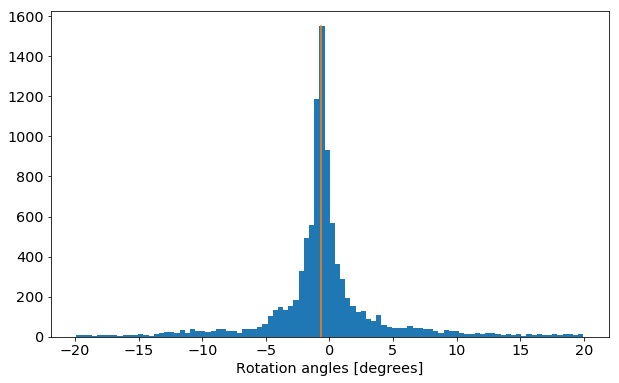

In [18]:
theta_hist = []
theta_hist = theta_mask[~np.isnan(theta_mask)].flatten()
theta_median = np.median(theta_hist)
print 'Angle median :',theta_median
fig = plt.figure(figsize=(10,6))
n,bins, patches = plt.hist(theta_hist,bins=int(np.sqrt(len(theta_hist))))
plt.plot([theta_median,theta_median],[0,np.max(n)])
plt.xlabel("Rotation angles [degrees]")
plt.show()

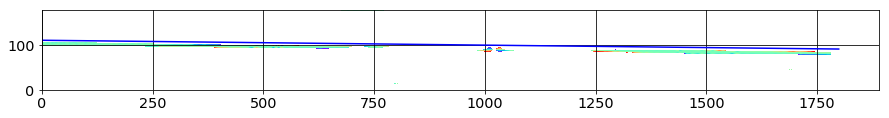

In [19]:
xindex=np.arange(data.shape[1])
x_new = np.linspace(xindex.min(),xindex.max(), 50)
#y_new = y0 - width_cut + (x_new-x0)*np.tan(theta_median*np.pi/180.)
# really want to see of hessian an straight line math SDC : Sept 25 2017
y_new = y0   + (x_new-x0)*np.tan(theta_median*np.pi/180.)
plt.imshow(theta_mask,origin='lower',cmap='rainbow',vmin=-deg_threshold,vmax=deg_threshold)
plt.plot(x_new,y_new,'b-')
plt.grid(color='black', ls='solid')
plt.show()


Rotation angle from fit : -0.734794753453


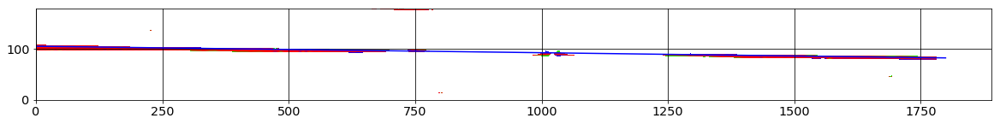

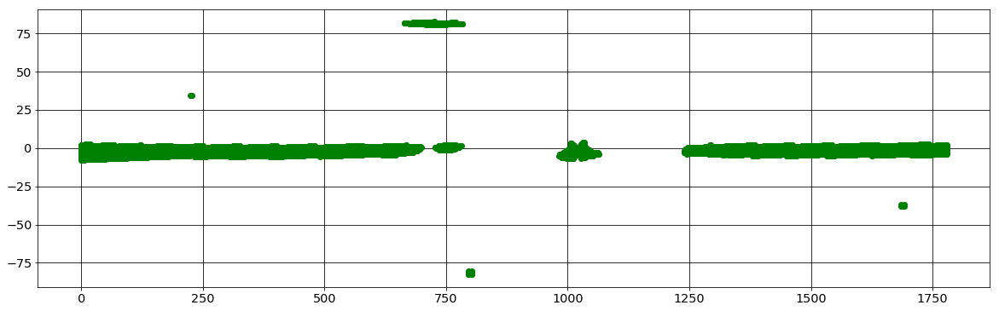

In [20]:
xtofit=[]
ytofit=[]
for iy,y in enumerate(theta_mask):
    for ix,x in enumerate(y):
        if not np.isnan(theta_mask[iy][ix]) :
            if np.abs(theta_mask[iy][ix])>deg_threshold : continue
            xtofit.append(ix)
            ytofit.append(iy)
popt, pcov = fit_line(xtofit, ytofit)
[a, b] = popt
x_new = np.linspace(xindex.min(),xindex.max(), 50)
y_new = line(x_new,a,b)
print 'Rotation angle from fit :',np.arctan(a)*180/np.pi
fig = plt.figure(figsize=[20,6])
plt.imshow(theta_mask,origin='lower',cmap=cm.brg,vmin=-deg_threshold,vmax=deg_threshold)
plt.plot(x_new,y_new,'b-')
plt.grid(color='black', ls='solid')
plt.show()
fig = plt.figure(figsize=[20,6])
diff = []
for ix,x in enumerate(xtofit):
    diff.append(ytofit[ix]-line(x,a,b))
plt.plot(xtofit,diff,'go')
plt.grid(color='black', ls='solid')
plt.show()

Using Hessian theta angles:
0  theta =  -0.631328217109
1  theta =  -0.722092660425
2  theta =  -0.618445201583
3  theta =  -0.720939264498
4  theta =  -0.96725638728
5  theta =  -1.85657427625
6  theta =  -1.47321773733
7  theta =  -0.630236090877
8  theta =  -0.728008954576
9  theta =  -0.971468144013
10  theta =  -1.87780434799
11  theta =  -1.499524102
12  theta =  -0.624036739761
13  theta =  -0.69207943038
14  theta =  -0.959985905424
15  theta =  -1.87159730712
16  theta =  -1.50410768476
17  theta =  -0.614466545403
18  theta =  -0.737327783045
19  theta =  -0.969157682333
20  theta =  -1.89542756168
21  theta =  -1.51307971856
22  theta =  -0.638799930184
23  theta =  -0.798098504075
24  theta =  -0.955615454145
25  theta =  -1.87298508681
26  theta =  -1.52640159835
27  theta =  -0.607123516118
28  theta =  -0.824709053387
29  theta =  -0.941323248703
30  theta =  -1.89087996828
31  theta =  -1.55521815633
32  theta =  -0.608024074318
33  theta =  -0.811694217868
34  theta = 

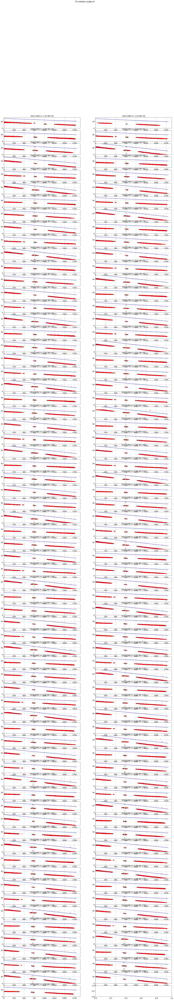

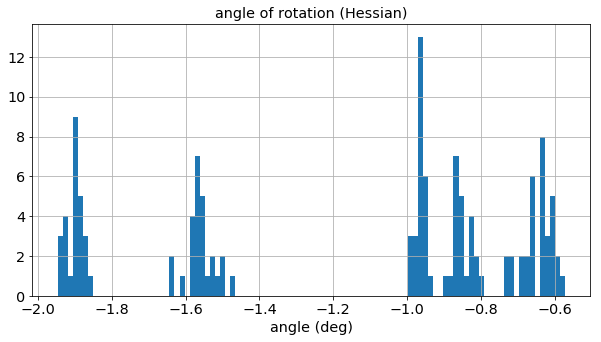

In [21]:
print 'Using Hessian theta angles:'

all_theta=ComputeRotationAngleHessian(all_images,x_guess,DeltaY,all_titles,object_name, 
    NBIMGPERROW=2, lambda_threshold = -2, deg_threshold = 20, width_cut = 40, right_edge = 1800, margin_cut = 10)
figfilename=os.path.join(dir_top_images,'fit_rotation.pdf')
plt.savefig(figfilename)  

for index in range(len(all_theta)):
    print index,' theta = ',all_theta[index]
plt.figure(figsize=(10,5))
n, bins, patches=plt.hist(all_theta,bins=100,histtype='stepfilled')
plt.grid(True)
plt.title('angle of rotation (Hessian)')
plt.xlabel('angle (deg)')

# Turn the images accordingly

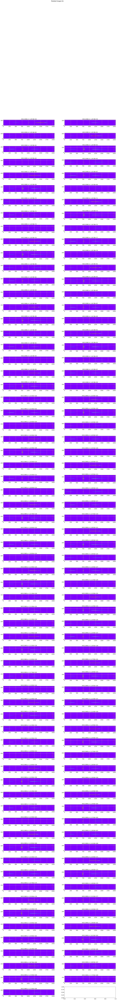

In [22]:
turned_images=TurnTheImages(all_images,all_theta,all_titles,object_name,
                            NBIMGPERROW=2,vmin=500,vmax=10000,oversample_factor=1)
figfilename=os.path.join(dir_top_images,'rotated_images.pdf')
plt.savefig(figfilename)  

# Check rotations

array([ 0.00587198,  0.01094707,  0.03596388,  0.08252873,  0.0125657 ,
        0.0509775 ,  0.01520653,  0.03318376,  0.05707168,  0.05494386,
        0.04448043,  0.03349502,  0.02034018,  0.00400711, -0.00030843,
        0.06934248,  0.03708359,  0.03313587, -0.00442846,  0.04901867,
        0.03657116,  0.07982413,  0.02957049,  0.0235061 ,  0.05736703,
        0.05359445,  0.03273807,  0.03866138,  0.04844123, -0.00673789,
        0.06348181,  0.05347471,  0.01913396,  0.01283452,  0.0706052 ,
        0.05290788,  0.04699978,  0.03236339,  0.02985327, -0.02811592,
        0.03541701,  0.09119958,  0.03411029, -0.01749217,  0.10449942,
        0.03288171,  0.07321037,  0.03049681, -0.02608279,  0.08164426,
        0.05455937,  0.03321665,  0.0385759 ,  0.05897492,  0.07623242,
        0.05168541,  0.07225547,  0.02706743, -0.0205303 ,  0.043647  ,
        0.03482609,  0.05338374,  0.03436806, -0.01073742,  0.10241141,
        0.0762223 ,  0.0819212 ,  0.00650006, -0.01725436, -0.02

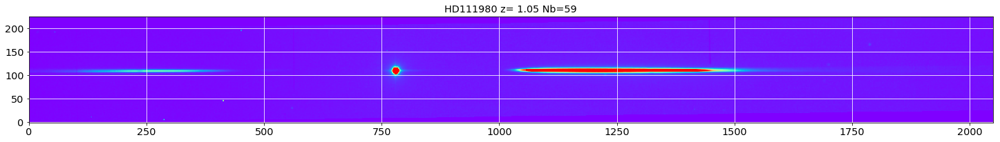

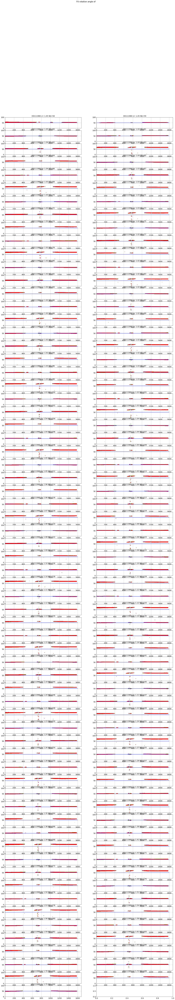

In [23]:
sel=1
plt.figure(figsize=(25,10))
plt.imshow(turned_images[sel],origin='lower',cmap='rainbow',vmin=0,vmax=1000)
plt.grid(True)
plt.title(all_titles[sel])
plt.grid(color='white', ls='solid')
figfilename=os.path.join(dir_top_images,'rotated_image_sample.pdf')
plt.savefig(figfilename)  

ComputeRotationAngleHessian(turned_images,x_guess,DeltaY,all_titles,object_name,
    NBIMGPERROW=2, lambda_threshold = -2, deg_threshold = 20, width_cut = 50, right_edge = 1600, margin_cut = 10)

In [ ]:
debug=True
if debug:
    for sel in range(len(turned_images)):
        plt.figure(figsize=(25,5))
        plt.imshow(turned_images[sel],origin='lower',cmap='rainbow',vmin=0,vmax=10000)
        plt.grid(True)
        plt.title(all_titles[sel])
        plt.grid(color='white', ls='solid')

## Must guess again the new centers for rotation

In [24]:
# guess the region where the maximum is
Delta_x02=[500,1100]
Delta_y02=[50,150]
dwc2=40

In [25]:
turned_images[0].shape

(223, 2050)

In [28]:
Guess_init_fit(turned_images[0],Delta_x02[0],Delta_x02[1],Delta_y02[0],Delta_y02[1])

(1031, 113)

In [33]:
# guess the region where the maximum is
#x0c2=750 # center expected for the central star
#y0c2=110 # center expected for the central star
#dwc2=100 # width

x_guess2,y_guess2=guess_central_position(turned_images,Delta_x02,Delta_y02,dwc2,filt0_idx,filt1_idx,filt2_idx,filt3_idx,filt4_idx,filt5_idx)

0 : (x_guess,y_guess)= 1031.03783246 112.124378063
1 : (x_guess,y_guess)= 779.051012258 110.335314875
2 : (x_guess,y_guess)= 781.50193453 108.446438024
3 : (x_guess,y_guess)= 781.276117706 110.026224505
4 : (x_guess,y_guess)= 781.758485954 113.375034262
5 : (x_guess,y_guess)= 783.281802731 125.779987656
6 : (x_guess,y_guess)= 782.340884735 120.706460744
7 : (x_guess,y_guess)= 779.684012224 109.600395431
8 : (x_guess,y_guess)= 779.777479411 110.837164069
9 : (x_guess,y_guess)= 779.546452383 114.405694035
10 : (x_guess,y_guess)= 781.66150685 125.677284858
11 : (x_guess,y_guess)= 780.56842006 121.269818339
12 : (x_guess,y_guess)= 777.256248967 108.37671533
13 : (x_guess,y_guess)= 776.833761037 109.7333142
14 : (x_guess,y_guess)= 777.80523346 112.659359137
15 : (x_guess,y_guess)= 779.341189425 125.488327397
16 : (x_guess,y_guess)= 777.466285817 120.579750527
17 : (x_guess,y_guess)= 776.632449386 108.846158213
18 : (x_guess,y_guess)= 776.838650543 110.512404905
19 : (x_guess,y_guess)= 776.9

In [34]:
ar2 = {'x_guess2' :x_guess2, 'y_guess2' : y_guess2,'theta' :all_theta}
df2 = pd.DataFrame(ar2)

In [36]:
df2.head()

,theta,x_guess2,y_guess2
0,-0.631328,1031.037832,112.124378
1,-0.722093,779.051012,110.335315
2,-0.618445,750.000000,108.446438
3,-0.720939,781.276118,110.026225
4,-0.967256,781.758486,113.375034


In [37]:
df2.to_csv('x_y_guess2.csv')

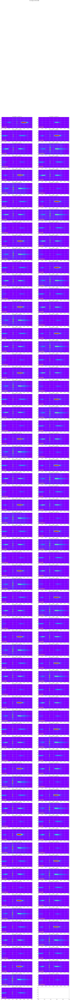

In [44]:
DeltaX=[2000]*len(all_images)
DeltaY_rot2 = [50]*len(all_images) # change from 20 to 50 to see well the central star
x_guess_rot2 = x_guess2
y_guess_rot2 = y_guess2
images_cut_rot=ShowCenterImages(x_guess_rot2,y_guess_rot2,DeltaX,DeltaY_rot2,
                    turned_images,all_titles,all_filt,object_name,NBIMGPERROW=2,vmin=0,vmax=10000) 

# Find the central star locations
======================================

### Central star positions after rotation and cut

First stage : show the rotated images which were cut
Second stage : show the images cut before they were cut


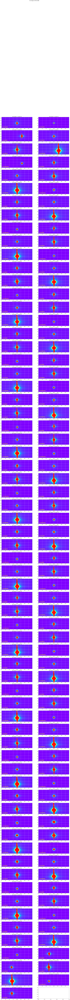

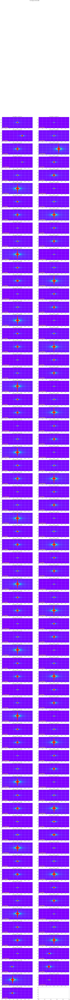

In [45]:
x_guess_rot = x_guess2
y_guess_rot = y_guess2
DeltaY_rot = [100]*len(all_images)
DeltaX_rot = [100]*len(all_images)
# First stage : show the rotated images which were cut
print 'First stage : show the rotated images which were cut'
images_cut=ShowCenterImages(x_guess_rot,y_guess_rot,DeltaX_rot,DeltaY_rot,
                    images_cut_rot,all_titles,all_filt,object_name,NBIMGPERROW=2,vmin=0,vmax=10000) 
# Second stage : show the images cut before they were cut
print 'Second stage : show the images cut before they were cut'
images_cut_before_rot=ShowCenterImages(x_guess,[100]*len(all_images),DeltaX_rot,DeltaY_rot,
                    all_images,all_titles,all_filt,object_name,NBIMGPERROW=2,vmin=0,vmax=10000) 

In [46]:
# (JN) valeurs optimisées pour cette étude
img_mean,img_median,img_std,img_sources=ComputeStatImages(images_cut,fwhm=9,threshold=10,sigma=10.0,iters=5)

----------------------------------------------------------------
0  mean, median, std =  258.261379428 208.082211947 179.872294184
 id xcentroid ycentroid sharpness roundness1 roundness2 npix sky peak flux mag
--- --------- --------- --------- ---------- ---------- ---- --- ---- ---- ---
----------------------------------------------------------------
1  mean, median, std =  42.495631528 34.1230280317 35.7118896211
 id   xcentroid     ycentroid   ...      peak          flux          mag      
--- ------------- ------------- ... ------------- ------------- --------------
  1 100.064277665 40.3113744838 ... 58663.1873155 381.825419157 -6.45466209296
----------------------------------------------------------------
2  mean, median, std =  201.29311533 125.491353107 304.740486886
 id xcentroid ycentroid sharpness roundness1 roundness2 npix sky peak flux mag
--- --------- --------- --------- ---------- ---------- ---- --- ---- ---- ---
--------------------------------------------------------

        Use DAOStarFinder instead. [astropy.utils.decorators]


 id   xcentroid     ycentroid   ...      peak         flux           mag      
--- ------------- ------------- ... ------------- ------------ ---------------
  1 131.867157995 4.36451848649 ... 60696.7888339 1.6810485204 -0.563950621849
----------------------------------------------------------------
6  mean, median, std =  56.2588825174 32.9611290309 93.3006952041
 id   xcentroid     ycentroid   ...     peak         flux          mag      
--- ------------- ------------- ... ------------ ------------ --------------
  1 132.318259185 30.7318564128 ... 60393.615206 196.38080372 -5.73274758279
----------------------------------------------------------------
7  mean, median, std =  200.330909311 120.974769359 318.485470585
 id xcentroid ycentroid sharpness roundness1 roundness2 npix sky peak flux mag
--- --------- --------- --------- ---------- ---------- ---- --- ---- ---- ---
----------------------------------------------------------------
8  mean, median, std =  242.250441175 193.17644

----------------------------------------------------------------
35  mean, median, std =  3009.01467192 495.790787685 10482.8554786
 id   xcentroid     ycentroid   ...      peak         flux           mag      
--- ------------- ------------- ... ------------- ------------ ---------------
  1 101.446451751 4.22025913817 ... 59870.9333042 1.7253504095 -0.592193278172
----------------------------------------------------------------
36  mean, median, std =  53.2905419468 30.9423862353 89.2754453708
 id   xcentroid     ycentroid   ...     peak          flux          mag      
--- ------------- ------------- ... ------------ ------------- --------------
  1 100.688533766 29.4191684063 ... 60299.856223 204.181647329 -5.77504175841
----------------------------------------------------------------
37  mean, median, std =  188.88249456 109.470052331 321.981386879
 id xcentroid ycentroid sharpness roundness1 roundness2 npix sky peak flux mag
--- --------- --------- --------- ---------- ----------

 id xcentroid ycentroid sharpness roundness1 roundness2 npix sky peak flux mag
--- --------- --------- --------- ---------- ---------- ---- --- ---- ---- ---
----------------------------------------------------------------
65  mean, median, std =  3171.78004764 476.848518756 10953.9808975
 id  xcentroid     ycentroid   ...      peak          flux           mag      
--- ------------ ------------- ... ------------- ------------- ---------------
  1 101.43978112 4.47039380649 ... 60041.7380503 1.58171616802 -0.497821384815
----------------------------------------------------------------
66  mean, median, std =  49.5550229616 28.0607592358 87.6697951437
 id   xcentroid     ycentroid   ...     peak          flux          mag      
--- ------------- ------------- ... ------------ ------------- --------------
  1 100.129018272 30.8276837208 ... 60480.860773 214.366164744 -5.82789059499
----------------------------------------------------------------
67  mean, median, std =  176.923540018 103

----------------------------------------------------------------
92  mean, median, std =  160.21106713 85.9673395648 290.419525973
 id xcentroid ycentroid sharpness roundness1 roundness2 npix sky peak flux mag
--- --------- --------- --------- ---------- ---------- ---- --- ---- ---- ---
----------------------------------------------------------------
93  mean, median, std =  176.255260832 129.86360558 170.498916611
 id xcentroid ycentroid sharpness roundness1 roundness2 npix sky peak flux mag
--- --------- --------- --------- ---------- ---------- ---- --- ---- ---- ---
----------------------------------------------------------------
94  mean, median, std =  1658.74137773 203.848598752 7851.42305485
 id xcentroid ycentroid sharpness roundness1 roundness2 npix sky peak flux mag
--- --------- --------- --------- ---------- ---------- ---- --- ---- ---- ---
----------------------------------------------------------------
95  mean, median, std =  3231.00205783 414.909098099 11231.6627512


 id xcentroid ycentroid sharpness roundness1 roundness2 npix sky peak flux mag
--- --------- --------- --------- ---------- ---------- ---- --- ---- ---- ---
----------------------------------------------------------------
120  mean, median, std =  3244.38790418 424.612790522 11263.9632134
 id   xcentroid     ycentroid   ...      peak         flux           mag      
--- ------------- ------------- ... ------------- ------------ ---------------
  1 101.179319359 4.14068293116 ... 60650.2507951 1.5970426438 -0.508291281769
----------------------------------------------------------------
121  mean, median, std =  45.6902035326 24.9470181838 84.0371512429
 id   xcentroid     ycentroid   ...      peak          flux          mag      
--- ------------- ------------- ... ------------- ------------- --------------
  1 100.882954752 30.3381816788 ... 60597.5419317 218.153169564 -5.84690381816
----------------------------------------------------------------
122  mean, median, std =  160.0065275

In [47]:
print 'total number of images',len(images_cut)
print 'number of centroid found ',len(img_sources)

total number of images 133
number of centroid found  133


# Central star postion

take the brightest

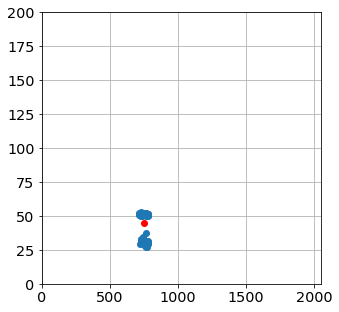

In [48]:
x_star = []
y_star = []
for index,s in enumerate(img_sources):
    for ss in s:
        x_star.append(ss['xcentroid']+x_guess_rot[index]-DeltaX_rot[index])
        y_star.append(ss['ycentroid']+y_guess_rot[index]-DeltaY_rot[index])
        
x_mean = np.mean(x_star)
y_mean = np.mean(y_star)
img_size=all_images[0].shape
plt.figure(figsize=(5,5))

# plot individual image center
plt.plot(x_star,y_star,'o')
# plot the average postion
plt.plot(x_mean,y_mean,'ro')
plt.xlim(0,img_size[1])
plt.ylim(0,img_size[0])
plt.grid(True)

In [49]:
print 'nuber of x_star = ',len(x_star)
print 'nuber of y_star = ',len(y_star)

nuber of x_star =  74
nuber of y_star =  74


> The problem is that DAOFIND may not find a center for each source. Thys the only solution
is to do the same thing : computing the average depending on each filter.

star number : 0
!! found no centroid
star number : 1
found  1  centroid 
star number : 2
!! found no centroid
star number : 3
found  1  centroid 
star number : 4
!! found no centroid
star number : 5
found  1  centroid 
star number : 6
found  1  centroid 
star number : 7
!! found no centroid
star number : 8
!! found no centroid
star number : 9
!! found no centroid
star number : 10
!! found no centroid
star number : 11
found  1  centroid 
star number : 12
!! found no centroid
star number : 13
found  1  centroid 
star number : 14
!! found no centroid
star number : 15
found  1  centroid 
star number : 16
found  1  centroid 
star number : 17
!! found no centroid
star number : 18
found  1  centroid 
star number : 19
!! found no centroid
star number : 20
found  1  centroid 
star number : 21
found  1  centroid 
star number : 22
!! found no centroid
star number : 23
found  1  centroid 
star number : 24
!! found no centroid
star number : 25
!! found no centroid
star number : 26
found  1  centroi

/Users/dagoret/anaconda/lib/python2.7/site-packages/numpy/core/fromnumeric.py:2889: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/dagoret/anaconda/lib/python2.7/site-packages/numpy/core/_methods.py:80: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


ValueError: x and y must have same first dimension, but have shapes (26,) and (2,)

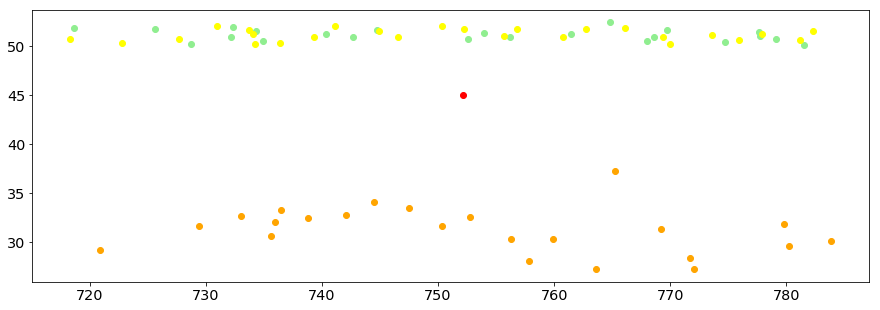

In [50]:

x_star = []
y_star = []

x_star_f0 = []
y_star_f0 = []

x_star_f1 = []
y_star_f1 = []

x_star_f2 = []
y_star_f2 = []

x_star_f3 = []
y_star_f3 = []

x_star_f4 = []
y_star_f4 = []

missing_centroid = []
missing_centroid_f0 = []
missing_centroid_f1 = []
missing_centroid_f2 = []
missing_centroid_f3 = []
missing_centroid_f4 = []


# loop on all image- source
for index,s in enumerate(img_sources):
    print "star number :",index
    if len(s) == 0:
        print '!! found no centroid'
        missing_centroid.append(index)
        
        if index in filt0_idx:
            missing_centroid_f0.append(index)
        
        if index in filt1_idx:
            missing_centroid_f1.append(index)
            
        if index in filt2_idx:
            missing_centroid_f2.append(index)   
            
        if index in filt3_idx:
            missing_centroid_f3.append(index)     

        if index in filt4_idx:
            missing_centroid_f4.append(index) 
            
    else:
        print 'found ',len(s),' centroid '
        # loop on individual sources in the image
        for ss in s:
            x_star.append(ss['xcentroid']+x_guess_rot[index]-DeltaX_rot[index])
            y_star.append(ss['ycentroid']+y_guess_rot[index]-DeltaY_rot[index])
        
            if index in filt0_idx:
                x_star_f0.append(ss['xcentroid']+x_guess_rot[index]-DeltaX_rot[index])
                y_star_f0.append(ss['ycentroid']+y_guess_rot[index]-DeltaY_rot[index])
        
            if index in filt1_idx:
                x_star_f1.append(ss['xcentroid']+x_guess_rot[index]-DeltaX_rot[index])
                y_star_f1.append(ss['ycentroid']+y_guess_rot[index]-DeltaY_rot[index])
            
            if index in filt2_idx:
                x_star_f2.append(ss['xcentroid']+x_guess_rot[index]-DeltaX_rot[index])
                y_star_f2.append(ss['ycentroid']+y_guess_rot[index]-DeltaY_rot[index])
            
            if index in filt3_idx:
                x_star_f3.append(ss['xcentroid']+x_guess_rot[index]-DeltaX_rot[index])
                y_star_f3.append(ss['ycentroid']+y_guess_rot[index]-DeltaY_rot[index])            

            if index in filt4_idx:
                x_star_f4.append(ss['xcentroid']+x_guess_rot[index]-DeltaX_rot[index])
                y_star_f4.append(ss['ycentroid']+y_guess_rot[index]-DeltaY_rot[index])        
        
x_mean = np.mean(x_star)
y_mean = np.mean(y_star)

x0_mean = np.mean(x_star_f0)
y0_mean = np.mean(y_star_f0)



x1_mean = np.mean(x_star_f1)
y1_mean = np.mean(y_star_f1)

x2_mean = np.mean(x_star_f2)
y2_mean = np.mean(y_star_f2)

x3_mean = np.mean(x_star_f3)
y3_mean = np.mean(y_star_f3)

x4_mean = np.mean(x_star_f4)
y4_mean = np.mean(y_star_f4)

print 'SUMMARY ::'
print '=========='

print '\t - Found ', len(x_star_f0), ' for filters ',filt_names[0]
print '\t - Found ', len(x_star_f1), ' for filters ',filt_names[1]
print '\t - Found ', len(x_star_f2), ' for filters ',filt_names[2]
print '\t - Found ', len(x_star_f3), ' for filters ',filt_names[3]
print '\t - Found ', len(x_star_f4), ' for filters ',filt_names[4]

print '\t - Missing centroids for indexes', missing_centroid
print '\t - Missing centroids for filter ',filt_names[0], ' : idx = ',missing_centroid_f0
print '\t - Missing centroids for filter ',filt_names[1], ' : idx = ',missing_centroid_f1
print '\t - Missing centroids for filter ',filt_names[2], ' : idx = ',missing_centroid_f2
print '\t - Missing centroids for filter ',filt_names[3], ' : idx = ',missing_centroid_f3
print '\t - Missing centroids for filter ',filt_names[4], ' : idx = ',missing_centroid_f4

img_size=all_images[0].shape
plt.figure(figsize=(15,5))

# plot individual image center

# plot the average postion
plt.plot(x_mean,y_mean,'ro',label='average position')




plt.plot(x_star_f1,y_star_f1,marker='o',color='lightgreen',label=filt_names[0],lw=0)
plt.plot(x_star_f2,y_star_f2,marker='o',color='cyan',label=filt_names[1],lw=0)
plt.plot(x_star_f3,y_star_f3,marker='o',color='orange',label=filt_names[2],lw=0)
plt.plot(x_star_f4,y_star_f4,marker='o',color='yellow',label=filt_names[3],lw=0)
plt.plot(x_star_f4,y_star_f0,marker='o',color='magenta',label=filt_names[0],lw=0)

plt.plot(x_star,y_star,'k+')

plt.xlim(0,img_size[1])
#plt.ylim(0,img_size[0])
plt.ylim(0,200)
plt.grid(True)
plt.legend()




#### Given DAOFind can find 0 center or more than one, I prefer my guess with a gaussian fit

In [ ]:
# Not done because my initial guess is much better
#tmp = ShowCenterImages(x_star,y_star,DeltaX_rot,DeltaY_rot,
#                    images_cut_rot,all_titles,all_filt,object_name,NBIMGPERROW=2,vmin=0,vmax=20000) 

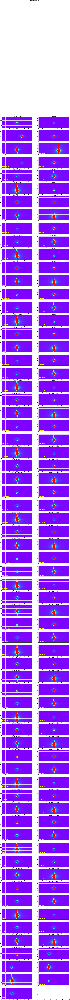

In [51]:
tmp = ShowCenterImages(x_guess_rot,y_guess_rot,DeltaX_rot,DeltaY_rot,images_cut_rot,all_titles,all_filt,object_name,NBIMGPERROW=2,vmin=0,vmax=20000) 

# Zero order positions before rotations

In [52]:
DeltaY_rot = [50]*len(all_images)
DeltaX_rot = [50]*len(all_images)
y_guess2 = DeltaY
images_raw_cut=ShowCenterImages(x_guess,y_guess2,DeltaX_rot,DeltaY_rot,
                    images_raw,all_titles,all_filt,object_name,NBIMGPERROW=2,vmin=0,vmax=10000) 

NameError: name 'images_raw' is not defined

In [ ]:
# (JN) valeurs optimisées pour cette étude
img_mean,img_median,img_std,img_sources=ComputeStatImages(images_raw_cut,fwhm=7,threshold=10,sigma=10.0,iters=5)

##### ! ça marche pas pour moi on j'utilise mon guess

[[ 1030.04822153  1020.56040991]
 [  778.0339466    701.43797984]
 [  749.           702.06663822]
 [  780.2606922    702.08821523]
 [  780.22463355   701.00414514]
 [  749.           701.33402808]
 [  748.           700.4620186 ]
 [  778.67598582   700.79460194]
 [  778.7725539    701.9449834 ]
 [  778.02990246   700.99129406]
 [  778.99397765   700.8810492 ]
 [  778.01042654   699.69606985]
 [  776.23681255   700.12078795]
 [  775.82065391   700.22691568]
 [  776.2639371    697.24816996]
 [  776.65289424   697.24997741]
 [  774.89434852   698.10720401]
 [  775.62197757   697.49480313]
 [  775.82825829   698.7025595 ]
 [  775.46966713   695.72858311]
 [  775.41489379   695.46313702]
 [  772.41510082   696.88710068]
 [  772.16265039   696.50453973]
 [  772.31237009   697.08229898]
 [  772.85754204   695.48538041]
 [  771.98433548   697.92869562]
 [  770.21802061   695.26939577]
 [  769.44245108   694.77945469]
 [  767.84076994   695.93130755]
 [  766.69863635   696.06180891]
 [  767.82

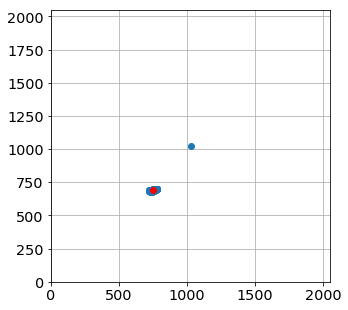

In [53]:
x_pointing = []
y_pointing = []
for index,s in enumerate(img_sources):
    #for ss in s:
    #    x_pointing.append(ss['xcentroid']+x_guess[index]-DeltaX_rot[index])
    #    y_pointing.append(ss['ycentroid']+y_guess[index]-DeltaY_rot[index])
    x_pointing.append(x_guess[index])
    y_pointing.append(y_guess[index])
    
        
x_mean = np.mean(x_pointing)
y_mean = np.mean(y_pointing)
img_size=all_images[0].shape
order0_positions = np.array([x_pointing,y_pointing]).T
print order0_positions
print x_star
plt.figure(figsize=(5,5))
plt.plot(order0_positions.T[0],order0_positions.T[1],'o')
plt.plot(x_mean,y_mean,'ro')
plt.xlim(0,IMSIZE)
plt.ylim(0,IMSIZE)
plt.grid(True)

#####  cherche le nom de l'hologramme

In [54]:
print all_filt

['dia Thor300', 'dia Thor300', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg

In [55]:
all_grat = []
for f in all_filt :
    #all_grat.append(f.replace('RG715 ',''))
    all_grat.append(f.replace('dia ',''))
for index,g in enumerate(all_grat):
    holo = Hologram(g,verbose=False)
    print g,holo.theta(order0_positions[index]), all_theta[index]

Thor300 -0.575 -0.631328217109
Thor300 -0.575 -0.722092660425
Ron400 -0.277 -0.618445201583
Thor300 -0.575 -0.720939264498
HoloPhP [-0.93742801] -0.96725638728
HoloPhAg [-1.48445194] -1.85657427625
HoloAmAg [-1.5111581] -1.47321773733
Ron400 -0.277 -0.630236090877
Thor300 -0.575 -0.728008954576
HoloPhP [-0.93464612] -0.971468144013
HoloPhAg [-1.51472654] -1.87780434799
HoloAmAg [-1.54022486] -1.499524102
Ron400 -0.277 -0.624036739761
Thor300 -0.575 -0.69207943038
HoloPhP [-0.93594909] -0.959985905424
HoloPhAg [-1.52132412] -1.87159730712
HoloAmAg [-1.54313354] -1.50410768476
Ron400 -0.277 -0.614466545403
Thor300 -0.575 -0.737327783045
HoloPhP [-0.93642081] -0.969157682333
HoloPhAg [-1.52452604] -1.89542756168
HoloAmAg [-1.54537005] -1.51307971856
Ron400 -0.277 -0.638799930184
Thor300 -0.575 -0.798098504075
HoloPhP [-0.93347877] -0.955615454145
HoloPhAg [-1.51508659] -1.87298508681
HoloAmAg [-1.54936266] -1.52640159835
Ron400 -0.277 -0.607123516118
Thor300 -0.575 -0.824709053387
HoloPhP

## Save results

- Save the cut images after rotation
- Save also info on the position

In [56]:
newfullfilenames=[]
for idx,f in np.ndenumerate(sorted_files):
    short_infilename=f.split("/")[-1]
    short_partfilename=re.findall('^cutimg_(.*)',short_infilename)
    short_outfilename='rotimg_'+short_partfilename[0]
    newfullfilename=os.path.join(outputdir,short_outfilename)
    newfullfilenames.append(newfullfilename)

for idx,f in np.ndenumerate(newfullfilenames):
    prihdu = fits.PrimaryHDU(header=all_header[idx[0]],data=images_cut_rot[idx[0]])
    thdulist = fits.HDUList(prihdu)
    thdulist.writeto(f,overwrite=True)
textfilename=os.path.join(outputdir,'star_centroids.txt')
print textfilename
np.savetxt(textfilename,order0_positions,header="y_star x_star",fmt='%d')

!ls -l rotated_fitsimages

./rotated_fitsimages/star_centroids.txt
total 428800
-rw-r--r--  1 dagoret  staff  1650240 Oct  2 22:21 rotimg_20170530_058.fits
-rw-r--r--  1 dagoret  staff  1650240 Oct  2 22:21 rotimg_20170530_059.fits
-rw-r--r--  1 dagoret  staff  1650240 Oct  2 22:21 rotimg_20170530_060.fits
-rw-r--r--  1 dagoret  staff  1650240 Oct  2 22:21 rotimg_20170530_061.fits
-rw-r--r--  1 dagoret  staff  1650240 Oct  2 22:21 rotimg_20170530_062.fits
-rw-r--r--  1 dagoret  staff  1650240 Oct  2 22:21 rotimg_20170530_063.fits
-rw-r--r--  1 dagoret  staff  1650240 Oct  2 22:21 rotimg_20170530_064.fits
-rw-r--r--  1 dagoret  staff  1650240 Oct  2 22:21 rotimg_20170530_065.fits
-rw-r--r--  1 dagoret  staff  1650240 Oct  2 22:21 rotimg_20170530_066.fits
-rw-r--r--  1 dagoret  staff  1650240 Oct  2 22:21 rotimg_20170530_067.fits
-rw-r--r--  1 dagoret  staff  1650240 Oct  2 22:21 rotimg_20170530_068.fits
-rw-r--r--  1 dagoret  staff  1650240 Oct  2 22:21 rotimg_20170530_069.fits
-rw-r--r--  1 dagoret  staff  16502

In [57]:
ar3 = {'x_pointing' :x_pointing, 'y_pointing' : y_pointing,'theta' :all_theta}
df3 = pd.DataFrame(ar3)

In [58]:
df3.to_csv('xy_pointing.csv')

In [59]:
df3

,theta,x_pointing,y_pointing
0,-0.631328,1030.048222,1020.560410
1,-0.722093,778.033947,701.437980
2,-0.618445,749.000000,702.066638
3,-0.720939,780.260692,702.088215
4,-0.967256,780.224634,701.004145
5,-1.856574,749.000000,701.334028
6,-1.473218,748.000000,700.462019
7,-0.630236,778.675986,700.794602
8,-0.728009,778.772554,701.944983
9,-0.971468,778.029902,700.991294


# Extract spectra
===================================

In [ ]:
outputdir="./spectrum_fitsspec"
ensure_dir(outputdir)

inputdir="./rotated_fitsimages"
SelectTagRe='^rotimg_%s_([0-9]+).fits$' % date # regular expression to select the file
SearchTagRe='^rotimg_%s_[0-9]+.fits$' % date

In [ ]:
df=pd.read_csv('xy_pointing.csv')

In [ ]:
df.head()

In [ ]:
x_star=df["x_pointing"]
y_star=df["y_pointing"]

In [ ]:
sorted_numbers,sorted_files = MakeFileList([inputdir],MIN_IMGNUMBER,MAX_IMGNUMBER,SelectTagRe,SearchTagRe) 

all_dates,all_airmass,all_images,all_titles,all_header,all_expo,all_filt=BuildImages(sorted_files,sorted_numbers,object_name)

print 'Number of images:',len(all_images)

In [ ]:
ShowImages(all_images,all_titles,all_filt,object_name,NBIMGPERROW=2,vmin=0,vmax=10000)

In [ ]:
# Right spectrum
y_star=[60]*len(all_images)

ShowCenterImages([1300]*len(all_images),y_star,[500]*len(all_images),[30]*len(all_images),
                 all_images,all_titles,all_filt,object_name,NBIMGPERROW=2,vmin=0,vmax=2000)
title='Right part of spectrum of {} '.format(object_name)
plt.suptitle(title,size=16)
figfilename=os.path.join(dir_top_images,'rightorder.pdf')
plt.savefig(figfilename)  

In [ ]:
# Left spectrum
ShowCenterImages([110]*len(all_images),[60]*len(all_images),[500]*len(all_images),[30]*len(all_images),
                 all_images,all_titles,all_filt,object_name,NBIMGPERROW=2,vmin=0,vmax=2000)
title='Left part of spectrum of {} '.format(object_name)
plt.suptitle(title,size=16)
figfilename=os.path.join(dir_top_images,'leftorder.pdf')
plt.savefig(figfilename)  

# Extraction of the spectrum from the 2D - Images


### Check the transverse spectrum does not show multi-bum

This proves the rotation may be OK

In [ ]:
they0=ShowTransverseProfile(all_images,all_titles,object_name,all_expo,NBIMGPERROW=2,
                      DeltaX=1000,w=5,ws=[20,30],right_edge=1800,ylim=(1e2,2e7))

## Extract the longitudinal spectrum with its lateral bands

In [ ]:
thespectra,thespectraUp,thespectraDown=ExtractSpectra(they0,all_images,all_titles,object_name,all_expo,
                                                      w=3,ws=[10,30],right_edge=1800)

In [ ]:
sel=4

plt.figure(figsize=(18,8))
plt.plot(thespectra[sel],'r-') 
plt.plot(thespectraUp[sel],'b-') 
plt.plot(thespectraDown[sel],'g-')
#plt.plot(Clean_Av[sel],'m-')
plt.grid(True)
plt.ylim(0,500.)
figfilename=os.path.join(dir_top_images,'bckg_sample.pdf')
plt.savefig(figfilename) 

In [ ]:
thespectraAv=np.array(thespectraUp+thespectraDown)/2.


In [ ]:
ShowLongitBackground(thespectra,thespectraUp,thespectraDown,thespectraAv,all_titles,all_filt,object_name,
                     NBIMGPERROW=2,right_edge=1800)

In [ ]:
import math as m
from matplotlib.backends.backend_pdf import PdfPages
def ShowFullLongitBackground(spectra,spectraUp,spectraDown,spectraAv,all_titles,object_name,NBIMGPERROW,dir_top_images):
    """
    Show the background to be removed to the spectrum
    
    Implemented to write in a pdf file
    
    """
    NBSPEC=len(spectra)
    MAXIMGROW=max(2,m.ceil(NBSPEC/NBIMGPERROW))
    
    # fig file specif
    NBIMGROWPERPAGE=5  # number of rows per pages
    PageNum=0          # page counter
    figfilename=os.path.join(dir_top_images,'background_longprofile.pdf')
    pp = PdfPages(figfilename) # create a pdf file
    
    title='Longitudinal background Up/Down'.format(object_name)
    
    
    spec_index_min=100  # cut the left border
    spec_index_max=1900 # cut the right border
    star_halfwidth=70
    
    for index in np.arange(0,NBSPEC):
        
        
        if index%(NBIMGPERROW*NBIMGROWPERPAGE) == 0:
            f, axarr = plt.subplots(NBIMGROWPERPAGE,NBIMGPERROW,figsize=(25,30))
            f.suptitle(title,size=20)
            
        # index of image in the page    
        indexcut=index-PageNum*(NBIMGROWPERPAGE*NBIMGPERROW)    
        ix=indexcut%NBIMGPERROW
        iy=indexcut/NBIMGPERROW
        
        # plot what is wanted
        axarr[iy,ix].plot(spectra[index],'r-')
        axarr[iy,ix].plot(spectraUp[index],'b-')
        axarr[iy,ix].plot(spectraDown[index],'g-')
        axarr[iy,ix].plot(spectraAv[index],'m-')
        axarr[iy,ix].set_title(all_titles[index])
        axarr[iy,ix].grid(True)
        
        star_pos=np.where(spectra[index][:spec_index_max]==spectra[index][:spec_index_max].max())[0][0]
        max_y_to_plot=(spectra[index][star_pos+star_halfwidth:spec_index_max]).max()*1.2
        
        
        axarr[iy,ix].set_ylim(0.,max_y_to_plot)
        axarr[iy,ix].text(spec_index_min,max_y_to_plot*1.1/1.2, all_filt[index],verticalalignment='top', horizontalalignment='center',color='blue',fontweight='bold', fontsize=20)
        
        
        # save a new page
        if (index+1)%(NBIMGPERROW*NBIMGROWPERPAGE) == 0:
            PageNum+=1  # increase page Number
            f.savefig(pp, format='pdf')
            f.show()
        
        
    
    
    f.savefig(pp, format='pdf') 
    f.show()
    pp.close()

In [ ]:
ShowFullLongitBackground(thespectra,thespectraUp,thespectraDown,thespectraAv,all_titles,object_name,2,dir_top_images)

In [ ]:
ShowLongitBackground(thespectra,thespectraUp,thespectraDown,thespectraAv,all_titles,all_filt,object_name,
                     NBIMGPERROW=2,right_edge=1)

In [ ]:
Clean_Up, Clean_Do,Clean_Av=CleanBadPixels(thespectraUp,thespectraDown) 

In [ ]:
ShowLongitBackground(thespectra,Clean_Up,Clean_Do,Clean_Av,all_titles,object_name,dir_top_images)

## If OK then cleaning

In [ ]:
Clean_Up, Clean_Do,Clean_Av=CleanBadPixels(thespectraUp,thespectraDown) 

In [ ]:
ShowLongitBackground(thespectra,Clean_Up,Clean_Do,Clean_Av,all_titles,all_filt,object_name,
                     NBIMGPERROW=2,right_edge=1800)
figfilename=os.path.join(dir_top_images,'background_longprofile.pdf')
plt.savefig(figfilename)   

In [ ]:
sel=3
plt.figure(figsize=(18,8))
plt.plot(thespectra[sel],'r-') 
plt.plot(Clean_Up[sel],'b-') 
plt.plot(Clean_Do[sel],'g-')
plt.plot(Clean_Av[sel],'m-')
plt.grid(True)
plt.ylim(0,100.)

In [ ]:
thecorrspectra=CorrectSpectrumFromBackground(thespectra,Clean_Av)

ShowSpectrumProfile(thecorrspectra,all_titles,object_name,all_filt,NBIMGPERROW=2)
figfilename=os.path.join(dir_top_images,'correctedspectrum_profile.pdf')
plt.savefig(figfilename) 

In [ ]:
ShowSpectrumProfile(thecorrspectra,all_titles,object_name,all_filt,NBIMGPERROW=2,xlim=(750,1800))
figfilename=os.path.join(dir_top_images,'correctedspectrum_rightprofile.pdf')
plt.savefig(figfilename) 